In [1]:
import pandas as pd
from nixtla import NixtlaClient
from utilsforecast.losses import mae, rmse, smape, mse
from utilsforecast.evaluation import evaluate

import shap
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

# NixtlaClient

In [ ]:
# Instantiate the NixtlaClient
nixtla_client = NixtlaClient(
    api_key = 'Your_API_Key')

# Functions

In [40]:
# Data preparation for exogenous variables
def prepare_exogenous(df, target_cols, exo_cols_endwith=None, shared_exo_cols=None, lags=None, smoothing_cols_endwith=None, smoothing_window=7):
    """
    Prepare exogenous variables for the given target columns.
    
    Parameters:
    - df: DataFrame containing the data.
    - target_cols: List of target columns for which to prepare exogenous variables.
    - exo_cols_endwith: List of suffixes for exogenous variables (default is ["temperature"]).
    - shared_exo_cols: List of shared exogenous columns (default is None).
    - lags: List of lags to create for the exogenous variables (default is None).
    - smoothing_cols_endwith: List of suffixes for columns to apply smoothing (default is None).
    - smoothing_window: Window size for smoothing (default is 7).

    Returns:
    - Dictionary of DataFrames for each target column with exogenous variables.
    """

    df = df.copy()

    if exo_cols_endwith is None:
        exo_cols_endwith = ["temperature"]

    exo_cols = []
    for col in target_cols:
        exo_cols.append(list(col.replace("price", ew) for ew in exo_cols_endwith))
    print(f"Exogenous columns: {list(exo_cols)}")

    shared_exo_cols = shared_exo_cols or []

    # Apply smoothing if specified
    exo_cols_flat = [item for sublist in exo_cols for item in sublist]
    if smoothing_cols_endwith is not None:
        for col in exo_cols_flat:
            if any(col.endswith(suffix) for suffix in smoothing_cols_endwith):
                if col in df.columns:
                    print(f"Smoothing column: {col} with window size: {smoothing_window}")
                    df[col] = df[col].rolling(window=smoothing_window, min_periods=1).mean()

    # Interpolate missing values and resample to business days
    y_exo = {col: df[[col]+exos+shared_exo_cols].dropna(subset=[col]).asfreq("B").interpolate(method="time").reset_index(drop=False)
            for col, exos in zip(target_cols, exo_cols)}

    # Add lags for the exogenous variables if specified
    # if lags is not None:
    #     for key in y_exo:
    #         for lag in lags:
    #             y_exo[key][f"t_lag_{lag}"] = y_exo[key][key.replace("price", "temperature")].shift(lag)

    # Drop rows with NaN values after lagging
    y_exo = {key: y_exo[key].dropna().reset_index(drop=True) for key in y_exo}

    # Rename columns for stacking into a long format
    def name_mapper(col):
        if col=='date':
            return 'ds'
        elif col.endswith('price'):
            return 'y'
        elif col.split('_')[-1] in exo_cols_endwith: # Only works for columns name with single _
            return col.split('_')[-1]
        elif col in shared_exo_cols:
            return col
        else:
            return col

    for key in y_exo:
        y_exo[key] = y_exo[key].rename(name_mapper, axis=1)
        y_exo[key]["ds"] = pd.to_datetime(y_exo[key]["ds"])

    # Add unique_id to each target and exogenous series for identification in stacking
    y_exo = {key: y_exo[key].assign(unique_id=key) for key in y_exo}
    
    return y_exo

# Convert the dictionary of DataFrames into a single DataFrame
def dict2df(data_dict):
    """
    Convert a dictionary of DataFrames into a single DataFrame with unique_id and ds columns.
    
    Parameters:
    - data_dict: Dictionary of DataFrames with unique_id and ds columns.

    Returns:
    - DataFrame with unique_id, ds, and y columns.
    """
    if not isinstance(data_dict, dict):
        raise ValueError("Input must be a dictionary of DataFrames.")
    if not all(isinstance(df, pd.DataFrame) for df in data_dict.values()):
        raise ValueError("All values in the dictionary must be pandas DataFrames.")
    
    # check if all DataFrames have the same columns
    columns = set(data_dict[next(iter(data_dict))].columns)
    if not all(set(df.columns) == columns for df in data_dict.values()):
        raise ValueError("All DataFrames must have the same columns.")

    return pd.concat([df.assign(unique_id=key) for key, df in data_dict.items()], ignore_index=True)

def df_split(df, split_date=None):
    """
    Split the DataFrame into training and testing sets based on a split date.

    Parameters:
    - df: DataFrame to split.
    - split_date: Date to split the DataFrame (optional).

    Returns:
    - Tuple of (train_df, test_df) if split_date is provided, else (df, None).
    """
    split_date = pd.to_datetime(split_date)

    train_df = df.query("ds < @split_date").reset_index(drop=True)
    test_df = df.query("ds >= @split_date").reset_index(drop=True)

    return train_df, test_df

def evaluate_predictions(predict_df, test_y_df, forecast_col='TimeGPT'):
    """
    Evaluate the predictions on the validation set for each unique_id.
    
    Parameters:
    - predict_df: DataFrame containing the predictions.
    - test_y_df: DataFrame containing the true values for evaluation.
    
    Returns:
    - evaluation: DataFrame with evaluation metrics.
    """
    # Merge the true values into the predictions DataFrame
    temp_df = predict_df.copy()
    
    # Merge true values based on 'ds' and 'unique_id'
    temp_df = temp_df.merge(
        test_y_df[['ds', 'unique_id', 'y']],
        on=['ds', 'unique_id'],
        how='left',
        suffixes=('', '_true')
    )
    
    # Evaluate the predictions
    metrics = [mae]
    evaluation = evaluate(
        temp_df,
        metrics=metrics,
        time_col="ds",
        target_col="y",
        id_col="unique_id",
        # agg_fn="mean"  # Use mean aggregation for evaluation metrics
    )

    average_metrics = evaluation.groupby('metric')[forecast_col].mean()

    # insert average metrics into the evaluation DataFrame
    evaluation = pd.concat([
        evaluation,
        pd.DataFrame({
            'metric': average_metrics.index,
            forecast_col: average_metrics.values,
            'unique_id': ['average'] * len(average_metrics)
        })
    ], ignore_index=True)

    return evaluation

# Define functions for storing and formatting evaluation results

# Convert the evaluation DataFrame to a more readable format
def format_evaluation(evaluation):
    """
    Format the evaluation DataFrame to have a more readable structure.
    
    Parameters:
    - evaluation: DataFrame containing evaluation metrics.
    
    Returns:
    - Formatted DataFrame with unique_id as columns and metrics as rows.
    """
    formatted = evaluation.pivot(index='metric', columns='unique_id', values='TimeGPT')
    formatted = formatted.reset_index().rename_axis(None, axis=1)
    return formatted

def append_evaluation(storage_df, new_data, model_name="TimeGPT-1 Long Horizon", 
                      horizon=None, 
                      finetune=None, 
                      exo_features=None,
                      note=None,
                      exo_time=None,
                      train_y_exo_df=None, 
                      test_exo_df=None):
    """
    Append evaluation results to the evaluation DataFrame.

    Parameters:
    - storage_df: pd.DataFrame
        The DataFrame to which new evaluation results will be appended.
    - new_data: pd.DataFrame
        The evaluation results to append (output of evaluate_predictions).
    - model_name: str, default "TimeGPT-1 Long Horizon"
        Name of the model used for evaluation.
    - horizon: int, optional
        Forecast horizon used in the evaluation.
    - finetune: tuple or None, optional
        Tuple of (steps, depth) for fine-tuning, or None if not used.
    - exo_features: list or None, optional
        List of exogenous features used in the model.
    - exo_time: list or None, optional
        Additional exogenous time features.
    - train_y_exo_df: pd.DataFrame
        Training set DataFrame (used for extracting train period).
    - test_exo_df: pd.DataFrame
        Test set DataFrame (used for extracting test period).

    Returns:
    - storage_df: pd.DataFrame
        Updated DataFrame with the new evaluation results appended.
    """
    df = format_evaluation(new_data)
    
    df['Model'] = model_name
    df['Horizon'] = horizon
    df['Finetune steps'] = finetune[0] if finetune else 0
    df['Finetune depth'] = finetune[1] if finetune else 0

    # Exclude the 'ds', 'unique_id', and 'y' columns from exogenous features
    # Handle exogenous features and time features robustly
    exo_list = []
    if exo_features is not None:
        exo_list = [col for col in exo_features if col not in ['ds', 'unique_id', 'y']]
    if exo_time is not None:
        # If exo_list is None, treat as empty list
        if exo_list is None:
            exo_list = []
        exo_list = exo_list + exo_time
    df['Exogenous features'] = ', '.join(exo_list) if exo_list else 'None'
    df['Note'] = note
    df['Train start date'] = train_y_exo_df['ds'].min()
    df['Train end date'] = train_y_exo_df['ds'].max()
    df['Test start date'] = test_exo_df['ds'].min()
    df['Test end date'] = test_exo_df['ds'].max()

    df['Evaluation date'] = pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')

    # Ensure the storage DataFrame has the same columns as df
    if storage_df.empty:
        storage_df = df.copy()
    else:
        # Check if all columns in df are present in storage_df
        missing_cols = set(df.columns) - set(storage_df.columns)
        if missing_cols:
            print(f"Adding missing columns to storage DataFrame: {missing_cols}")
            for col in missing_cols:
                storage_df[col] = pd.NA
        # Ensure the order of columns matches
        storage_df = storage_df[df.columns]
        # Append the new data to the storage DataFrame  
        storage_df = pd.concat([storage_df, df], ignore_index=True)

    return storage_df

class SinCosWeekOfYear:
    """
    Adds sine and cosine features for each week of the year. This is useful for
    models that can benefit from understanding the periodicity of weeks in a year.
    """
    def __call__(self, dates: pd.DatetimeIndex):
        df = pd.DataFrame(index=dates)
        # Get week of year (1 to 53)
        weeks = np.array([date.isocalendar().week for date in dates])

        # Calculate sine and cosine features
        df["week_sin"] = np.sin((2 * np.pi) * (weeks-1) / 53).round(4)
        df["week_cos"] = np.cos((2 * np.pi) * (weeks-1) / 53).round(4)
        return df

    def __name__(self):
        return "SinCosWeekOfYear"

class SinCosDayOfYear:
    """
    Adds sine and cosine features for each day of the year. This is useful for
    models that can benefit from understanding the periodicity of days in a year.
    """
    def __call__(self, dates: pd.DatetimeIndex):
        df = pd.DataFrame(index=dates)
        # Get day of year (1 to 366)
        days = np.array([date.dayofyear for date in dates])

        # Calculate sine and cosine features
        df["day_sin"] = np.sin((2 * np.pi) * (days-1) / 366).round(4)
        df["day_cos"] = np.cos((2 * np.pi) * (days-1) / 366).round(4)
        return df

    def __name__(self):
        return "SinCosDayOfYear"
    
# # Example usage
# dates = pd.date_range(start='2023-01-01 00:00', periods=400, freq='B')
# sin_cos_day = SinCosDayOfYear()
# features = sin_cos_day(dates)

# # Plot the sine and cosine features
# plt.figure(figsize=(12, 6))
# plt.plot(features.index, features["day_sin"], label="Day Sin", color='blue')
# plt.plot(features.index, features["day_cos"], label="Day Cos", color='orange')
# plt.title("Sine and Cosine Features for Day of Year")
# plt.xlabel("Date")
# plt.ylabel("Value")
# plt.legend()
# plt.grid()
# plt.show()


# Load and prepare data

In [4]:
# Load and preprocess data
df = pd.read_csv("data/price_vol_temp_inven_mc_merged_cleaned_data.csv", parse_dates=["date"])
# df = df.set_index("date").sort_index()

# Cutoff date
cutoff_date_min = pd.to_datetime("2009-01-02") # Remove the first data point of ttf_price
cutoff_date_max = pd.to_datetime("2025-05-22") # pd.to_datetime("2020-06-30")
split_date = "2024-12-31" #"2020-01-01"
# df = df[(df.index >= cutoff_date_min) & (df.index <= cutoff_date_max)]
df = df.query("date >= @cutoff_date_min & date <= @cutoff_date_max")

# Choose core target series
target_cols = ["hh_price", "ttf_price", "psv_price", "jkm_price",]# "pvb_price"]
temp_cols = [s.replace("price", "temperature") for s in target_cols]
unique_ids = [s.replace("_price", "") for s in target_cols]

Fitting Fourier series for hh...


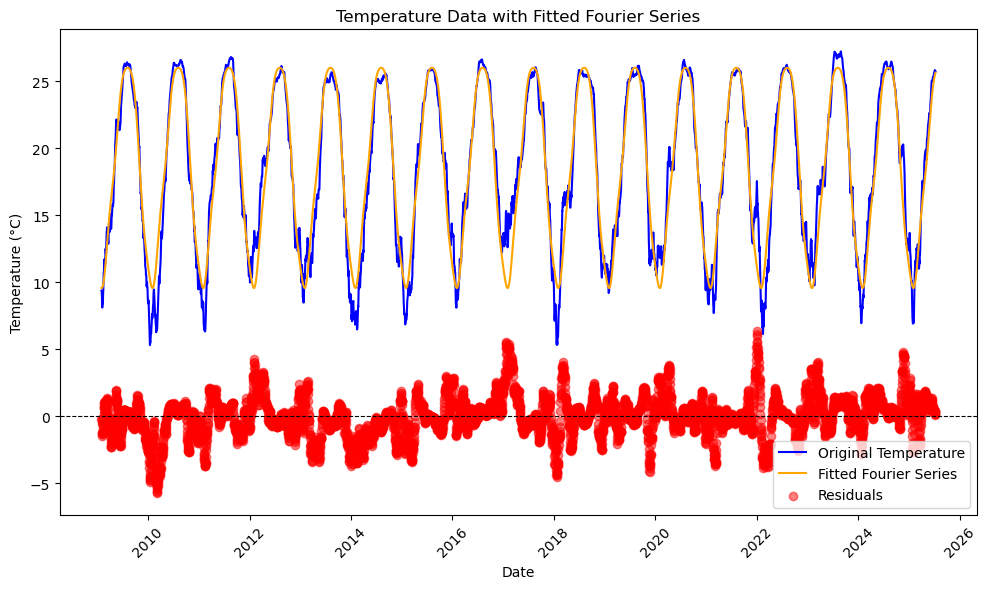

Fitting Fourier series for ttf...


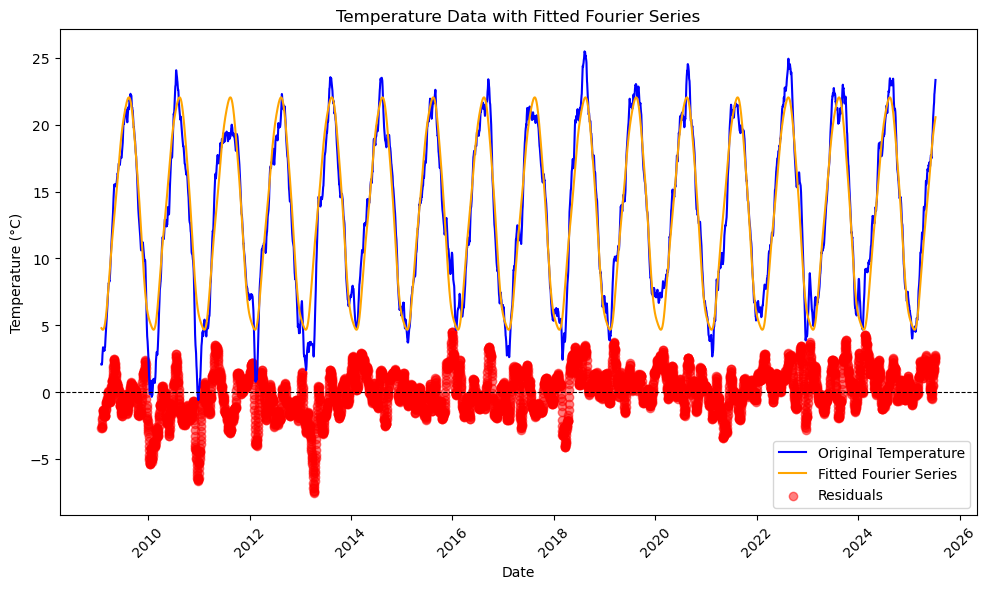

Fitting Fourier series for psv...


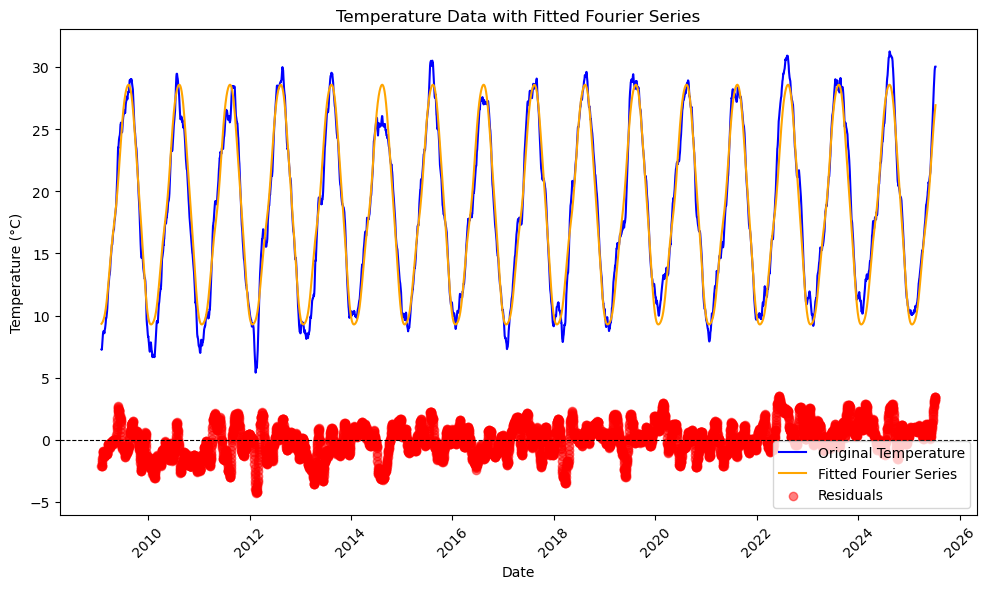

Fitting Fourier series for jkm...


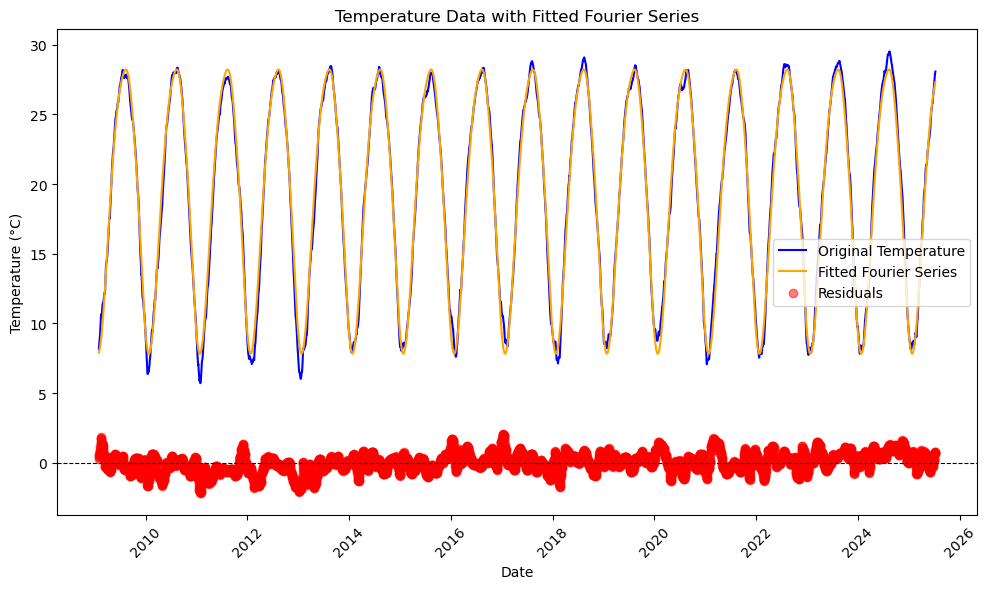

In [5]:
# Add the Fourier features for the temperature columns
from sklearn.base import BaseEstimator, TransformerMixin
import numpy as np

class FourierFeatures(BaseEstimator, TransformerMixin):
    def __init__(self, period=365.25, order=3):
        self.period = period
        self.order = order

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        t = np.asarray(X).reshape(-1, 1)
        features = [np.sin(2 * np.pi * t / self.period * i) for i in range(1, self.order + 1)]
        features += [np.cos(2 * np.pi * t / self.period * i) for i in range(1, self.order + 1)]
        return np.concatenate(features, axis=1)

# Example usage
from sklearn.linear_model import Ridge
from sklearn.pipeline import Pipeline

pipeline = Pipeline([
    ("fourier", FourierFeatures(period=365.25, order=5)),
    ("model", Ridge(random_state=1))
])

# Load temperature data. The df is in frequency of business days not suitable for Fourier series
df_temp = pd.read_csv('data/temperature_data_6_regions.csv', parse_dates=['date'])
df_temp.columns = df_temp.columns.str.lower()
df_temp['date'] = df_temp['date'].dt.floor('D')  # Set the date to the start of the day not 12:00:00 for merging

df_fourier = pd.DataFrame()
df_fourier['date'] = df_temp['date']

for wch in unique_ids:
    print(f"Fitting Fourier series for {wch}...")
    # Prepare the data
    t = np.arange(len(df_temp[wch])).reshape(-1, 1)
    pipeline.fit(t, df_temp[wch])
    fitted = pipeline.predict(t)
    residuals = df_temp[wch] - fitted

    # Insert the fitted Fourier series and residuals into the df which is in frequency of business days
    df_fourier = df_fourier.merge(
            pd.DataFrame({
                'date': df_temp['date'],
                f'{wch}_tFourier': fitted,
                f'{wch}_tResiduals': residuals
            }),
            on='date',
            how='left'
    )

    # Plot the original temperature data and the fitted Fourier series
    plt.figure(figsize=(10, 6))
    plt.plot(df_temp['date'], df_temp[f'{wch}'].rolling(window=30).mean(), label='Original Temperature', color='blue')
    plt.plot(df_fourier['date'], df_fourier[f'{wch}_tFourier'].rolling(window=30).mean(), label='Fitted Fourier Series', color='orange')
    plt.scatter(df_fourier['date'], df_fourier[f'{wch}_tResiduals'].rolling(window=30).mean(), label='Residuals', color='red', alpha=0.5)
    plt.axhline(0, color='black', linestyle='--', linewidth=0.8)
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.title('Temperature Data with Fitted Fourier Series')
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Merge the Fourier features into the main DataFrame
df = df.merge(df_fourier, on='date', how='left')

Calculating seasonal average features for hh...


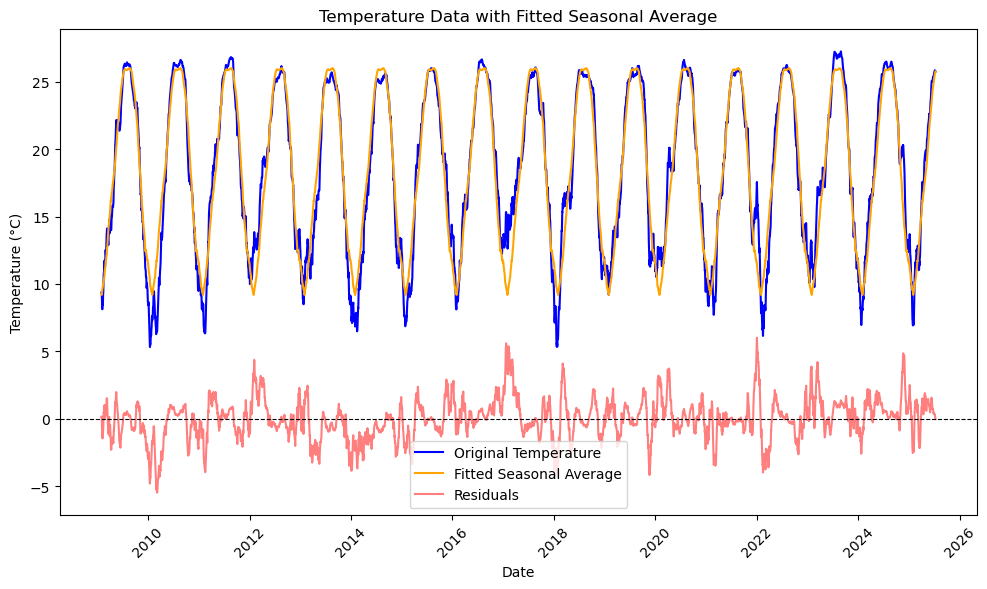

Calculating seasonal average features for ttf...


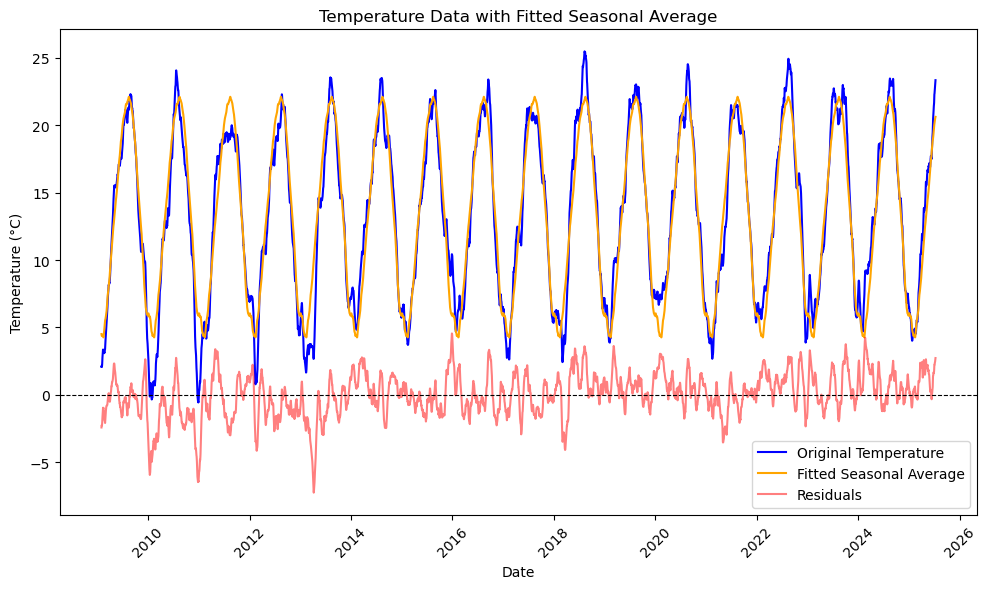

Calculating seasonal average features for psv...


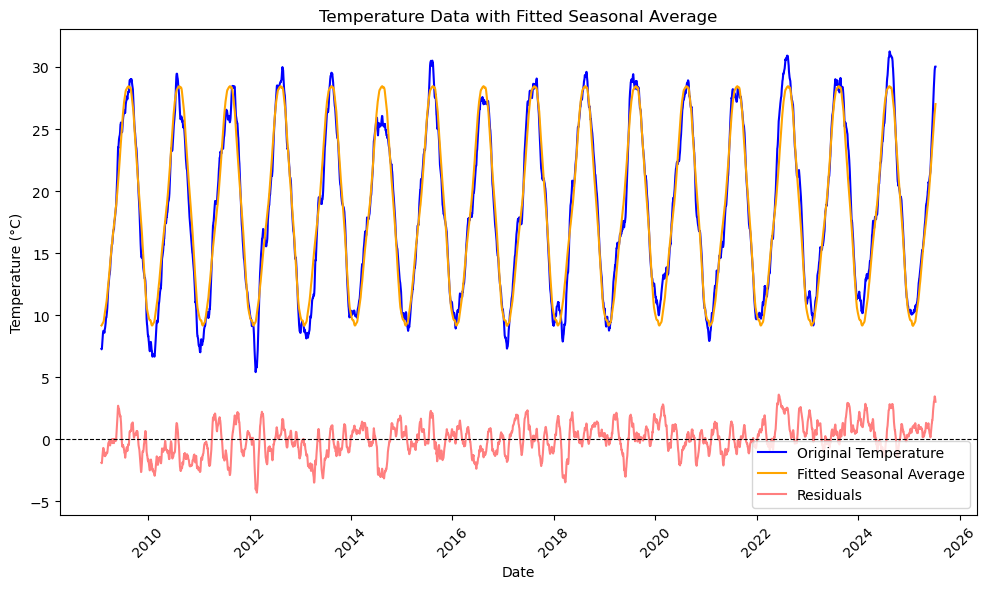

Calculating seasonal average features for jkm...


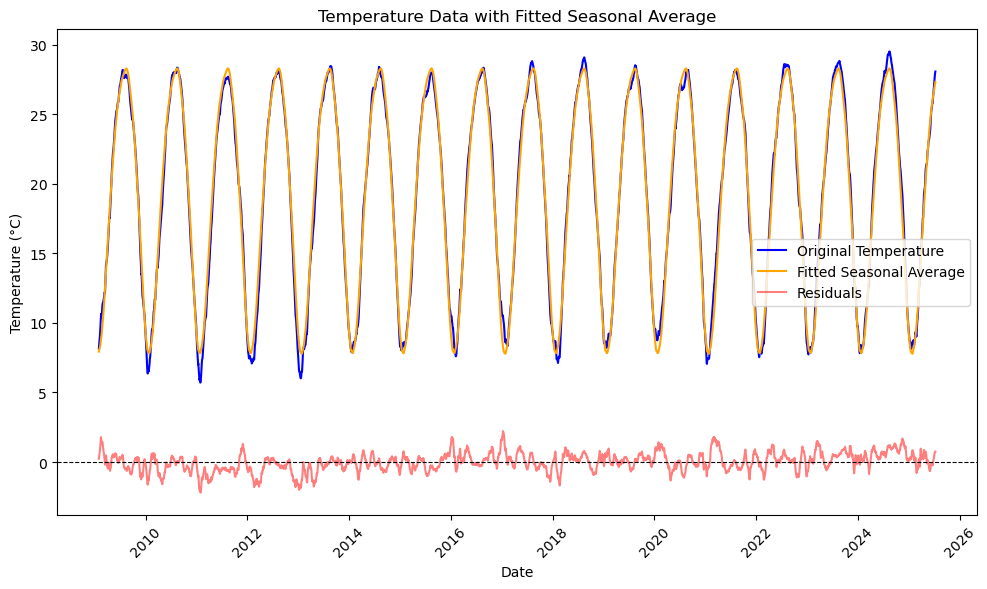

In [6]:
# Add seasonal average features and residuals for temperature data
def seasonal_average_features(df, column, smooth=False, window_size=10):
    """
    Calculate seasonal average features for a given temperature column.
    
    Parameters:
    - df: DataFrame containing the temperature data.
    - column: The name of the temperature column to process.
    - period: The period for seasonal averaging (default is 365.25 days).
    
    Returns:
    - DataFrame with seasonal average features.
    """
    df = df.copy()
    df['day_of_year'] = df['date'].dt.dayofyear
    seasonal_avg = df.groupby('day_of_year')[column].mean().reset_index()
    seasonal_avg.rename(columns={column: f'{column}_seasonalAvg'}, inplace=True)

    # Merge back to the original DataFrame
    df = pd.merge(df, seasonal_avg, on='day_of_year', how='left')

    # Now smooth the merged seasonal average column
    if smooth:
        df[f'{column}_seasonalAvg'] = (
            df[f'{column}_seasonalAvg']
            .rolling(window=window_size, center=True, min_periods=1)
            .mean()
        )
    
    # Calculate residuals
    df[f'{column}_seasonalResiduals'] = df[column] - df[f'{column}_seasonalAvg']

    # Smooth the residuals if specified
    if smooth:
        df[f'{column}_seasonalResiduals'] = (
            df[f'{column}_seasonalResiduals']
            .rolling(window=window_size, center=True, min_periods=1)
            .mean()
        )
    
    return df

# Load temperature data. The df is in frequency of business days not suitable for Fourier series
df_temp = pd.read_csv('data/temperature_data_6_regions.csv', parse_dates=['date'])
df_temp.columns = df_temp.columns.str.lower()
df_temp['date'] = df_temp['date'].dt.floor('D')  # Set the date to the start of the day not 12:00:00 for merging

df_seasonal = pd.DataFrame()
df_seasonal['date'] = df_temp['date']

for wch in unique_ids:
    # Calculate seasonal average features and residuals
    print(f"Calculating seasonal average features for {wch}...")
    temp = seasonal_average_features(df_temp, wch)

    # Insert the seasonal average features and residuals into the df which is in frequency of business days
    df_seasonal = df_seasonal.merge(
            temp[['date', f'{wch}_seasonalAvg', f'{wch}_seasonalResiduals']],
            on='date',
            how='left'
    )

    # Plot the original temperature data and the fitted Fourier series
    plt.figure(figsize=(10, 6))
    plt.plot(df_temp['date'], df_temp[f'{wch}'].rolling(window=30).mean(), label='Original Temperature', color='blue')
    plt.plot(df_seasonal['date'], df_seasonal[f'{wch}_seasonalAvg'].rolling(window=30).mean(), label='Fitted Seasonal Average', color='orange')
    plt.plot(df_seasonal['date'], df_seasonal[f'{wch}_seasonalResiduals'].rolling(window=30).mean(), label='Residuals', color='red', alpha=0.5)
    plt.axhline(0, color='black', linestyle='--', linewidth=0.8)
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.title('Temperature Data with Fitted Seasonal Average')
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Merge the seasonal features into the main DataFrame
df = df.merge(df_seasonal, on='date', how='left')


In [7]:
# Add significant events as binary columns
# --- Event impact windows and step changes for exogenous features ---
def add_event_features(df, idx_col='date'):
    """
    Add binary indicator columns for major LNG/gas market events.
    Assumes df[idx_col] is datetime and set as index or column.
    """
    df = df.copy()
    # Ensure datetime index
    if idx_col in df.columns:
        df[idx_col] = pd.to_datetime(df[idx_col])
        df = df.set_index(idx_col)
    else:
        df.index = pd.to_datetime(df.index)

    # Define event features as a dictionary: {column_name: (start_date, end_date, type)}
    # type: 'step' for step change, 'window' for event window
    event_features = {
        'event_fukushima_2011':         ('2011-03-11', '2011-06-30', 'window'),
        'event_shale_gas_2012':         ('2012-04-01', None, 'step'),
        # 'event_polar_vortex_2014':      ('2014-01-15', '2014-03-15', 'window'), # cold snap in US
        # 'event_mild_winter_2016':       ('2015-12-01', '2016-03-31', 'window'), # mild winter in US
        # 'event_cold_snap_2018':         ('2018-11-01', '2019-02-28', 'window'), # cold snap in US
        'event_covid_shock_2020':       ('2020-03-01', '2021-06-30', 'window'), # '2020-09-30'
        # 'event_post_covid_2021':        ('2021-10-01', None, 'step'),
        'event_oil_crash_2020':         ('2020-03-01', '2020-06-30', 'window'),
        'event_brexit':                 ('2020-01-31', '2020-12-31', 'window'),
        'event_ukraine_war_acute_2022': ('2022-02-24', '2022-12-31', 'window'),
        'event_ukraine_war_step_2022':  ('2022-02-24', None, 'step'),
        'event_freeport_outage_2022':   ('2022-06-08', '2022-11-15', 'window'),
        'event_nordstream_halt_2022':   ('2022-08-31', None, 'step'),
        'event_eu_price_cap_2022':      ('2022-12-19', '2023-03-31', 'window'),
        # 'event_warm_winter_2023':       ('2023-03-01', '2023-06-30', 'window'),
        'event_lng_capacity_2024':      ('2024-01-01', None, 'step'),
    }

    for col, (start, end, typ) in event_features.items():
        if typ == 'step':
            df[col] = (df.index >= pd.to_datetime(start)).astype(int)
        elif typ == 'window':
            df[col] = ((df.index >= pd.to_datetime(start)) & (df.index <= pd.to_datetime(end))).astype(int)

    return df

df = add_event_features(df, idx_col='date')


# Test: data preparation and plot

In [8]:
# Testing the preparation of exogenous variables
# Update the exogenous variable list
exo_cols_endwith = ["temperature"]
# for individual price indexes, e.g. hh, ttf, psv, jkm, pvb
# ["seasonalAvg", "seasonalResiduals"] #["tFourier", "tResiduals"]
shared_exo_cols = [col for col in df.columns if col.startswith("event_")] # for major events

# Prepare exogenous variables for the target columns
y_exo_dict = prepare_exogenous(df, target_cols, 
                               exo_cols_endwith=exo_cols_endwith, 
                               shared_exo_cols=shared_exo_cols,
                               lags=None, 
                               smoothing_cols_endwith=None, smoothing_window=10)

# Check the length of each exogenous variable series
for key, value in y_exo_dict.items():
    print(f"{key}: {len(value)}")

# Stacking exogenous variables into a single long DataFrame
# This will allow us to handle multiple target series with their respective exogenous variables
# and prepare for training and testing splits
y_exo_df = dict2df(y_exo_dict)

Exogenous columns: [['hh_temperature'], ['ttf_temperature'], ['psv_temperature'], ['jkm_temperature']]
hh_price: 4275
ttf_price: 4275
psv_price: 3621
jkm_price: 2823


In [9]:
y_exo_df

,ds,y,temperature,event_fukushima_2011,event_shale_gas_2012,event_covid_shock_2020,event_oil_crash_2020,event_brexit,event_ukraine_war_acute_2022,event_ukraine_war_step_2022,event_freeport_outage_2022,event_nordstream_halt_2022,event_eu_price_cap_2022,event_lng_capacity_2024,unique_id
0,2009-01-02,5.410,17.224785,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,hh_price
1,2009-01-05,5.830,10.890604,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,hh_price
2,2009-01-06,6.100,9.658951,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,hh_price
3,2009-01-07,5.890,5.560003,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,hh_price
4,2009-01-08,5.960,9.868980,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,hh_price
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14989,2025-05-16,11.895,25.438738,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,jkm_price
14990,2025-05-19,11.965,26.081255,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,jkm_price
14991,2025-05-20,12.515,27.889145,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,jkm_price
14992,2025-05-21,12.480,27.467344,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,jkm_price


In [10]:
fig = nixtla_client.plot(y_exo_df, y_exo_df, 
                         time_col='ds', target_col="y", id_col="unique_id", engine='plotly')

fig.layout.update(title="Exogenous Variables with Major Events",
                  xaxis_title="Date",
                  yaxis_title="Value",
                  legend_title="Features",
                  height=900)
fig.show()

# Anomaly detection

In [ ]:
# Detect Anomalies for y (price) series
anomalies_df = nixtla_client.detect_anomalies(y_exo_df, time_col='ds', target_col='y', freq='B')

# Plot your results (optional)
nixtla_client.plot(y_exo_df, anomalies_df,time_col='ds', target_col='y', id_col="unique_id", engine="plotly")

INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using the following exogenous features: ['temperature']
INFO:nixtla.nixtla_client:Calling Anomaly Detector Endpoint...


In [ ]:
# Anomalies for temperature series
anomalies_temp_df = nixtla_client.detect_anomalies(y_exo_df, time_col='ds', target_col='temperature', freq='B')

# Plot anomalies for temperature
nixtla_client.plot(y_exo_df, anomalies_temp_df, time_col='ds', target_col='temperature', id_col="unique_id", engine="plotly")

INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using the following exogenous features: ['y']
INFO:nixtla.nixtla_client:Calling Anomaly Detector Endpoint...


# Train with/without exogenous

## Prepare data

In [33]:
# Prepare exogenous variables
exo_cols_endwith = ["temperature", 'tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals']
shared_exo_cols = [col for col in df.columns if col.startswith("event_")] # for major events

y_exo_dict = prepare_exogenous(df, target_cols, 
                               exo_cols_endwith=exo_cols_endwith,
                               shared_exo_cols=shared_exo_cols,
                               lags=None,
                               smoothing_cols_endwith=exo_cols_endwith,
                               smoothing_window=1)

# Stacking exogenous variables into a single long DataFrame
y_exo_df = dict2df(y_exo_dict)

# Train-test split using query
train_y_exo_df, test_y_exo_df = df_split(y_exo_df, split_date=split_date)

# Define the horizon for the test set based on the test length
horizon = len(test_y_exo_df[test_y_exo_df['unique_id'] == "hh_price"])  # Assuming all series have the same horizon

# Remove target values from the test set for future exogenous variables
test_exo_df = test_y_exo_df.drop(columns=["y"]) # future exogenous variables do not have target values
# test_exo_df['temperature'] = test_y_exo_df['tFourier']
# test_exo_df['temperature'] = test_y_exo_df['seasonalAvg'] # use seasonalAvg as a proxy for temperature
test_exo_df['tResiduals'] = 0
test_exo_df['seasonalResiduals'] = 0

# Check the length of test_exo_df for each target series
# they should equal length of the test set of different target series
for key in y_exo_dict.keys():
    print(f"{key} test length: {len(test_exo_df[test_exo_df['unique_id'] == key])}")

# train_y_exo_df

Exogenous columns: [['hh_temperature', 'hh_tFourier', 'hh_tResiduals', 'hh_seasonalAvg', 'hh_seasonalResiduals'], ['ttf_temperature', 'ttf_tFourier', 'ttf_tResiduals', 'ttf_seasonalAvg', 'ttf_seasonalResiduals'], ['psv_temperature', 'psv_tFourier', 'psv_tResiduals', 'psv_seasonalAvg', 'psv_seasonalResiduals'], ['jkm_temperature', 'jkm_tFourier', 'jkm_tResiduals', 'jkm_seasonalAvg', 'jkm_seasonalResiduals']]
Smoothing column: hh_temperature with window size: 1
Smoothing column: hh_tFourier with window size: 1
Smoothing column: hh_tResiduals with window size: 1
Smoothing column: hh_seasonalAvg with window size: 1
Smoothing column: hh_seasonalResiduals with window size: 1
Smoothing column: ttf_temperature with window size: 1
Smoothing column: ttf_tFourier with window size: 1
Smoothing column: ttf_tResiduals with window size: 1
Smoothing column: ttf_seasonalAvg with window size: 1
Smoothing column: ttf_seasonalResiduals with window size: 1
Smoothing column: psv_temperature with window size

In [238]:
train_y_exo_df

,ds,y,temperature,tFourier,tResiduals,seasonalAvg,seasonalResiduals,event_fukushima_2011,event_shale_gas_2012,event_covid_shock_2020,event_oil_crash_2020,event_brexit,event_ukraine_war_acute_2022,event_ukraine_war_step_2022,event_freeport_outage_2022,event_nordstream_halt_2022,event_eu_price_cap_2022,event_lng_capacity_2024,unique_id
0,2009-01-02,5.410000,17.224785,9.976746,7.248039,9.555549,7.669236,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,hh_price
1,2009-01-05,5.830000,10.890604,9.797123,1.093481,9.493323,1.397281,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,hh_price
2,2009-01-06,6.100000,9.658951,9.742652,-0.083701,7.668738,1.990213,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,hh_price
3,2009-01-07,5.890000,5.560003,9.691240,-4.131237,7.590569,-2.030566,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,hh_price
4,2009-01-08,5.960000,9.868980,9.643103,0.225877,8.958012,0.910968,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,hh_price
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15779,2024-12-24,46.590000,12.169342,10.612121,1.557221,11.014547,1.154795,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,pvb_price
15780,2024-12-25,47.426667,11.959868,10.574381,1.385487,11.020001,0.939867,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,pvb_price
15781,2024-12-26,48.263333,11.750394,10.536642,1.213752,11.025455,0.724939,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,pvb_price
15782,2024-12-27,49.100000,11.540920,10.498903,1.042017,11.030909,0.510011,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,pvb_price


In [22]:
# Visual checking the all data
# Trick in using the nixtla_client.plot function: plot(df_train, df_forecast...) 
# where only the target_col in df_train is plotted but all columns in df_forecast are plotted

target_col = "temperature" # "seasonalAvg"  # Choose the target column to plot
fig = nixtla_client.plot(
    train_y_exo_df, train_y_exo_df,  time_col="ds", target_col=target_col, id_col="unique_id", engine="plotly")

# share x axis
fig.update_xaxes(matches='x')
fig.update_layout(
    title="Exogenous Variables",
    xaxis_title="Date",
    yaxis_title="Value",
    legend_title="Exogenous Series",
    #width=1300,
    height=1500
)
fig.show()

# Visual checking the test data
target_col = "temperature" # "seasonalAvg"  # Choose the target column to
fig = nixtla_client.plot(
    test_exo_df, test_exo_df,  time_col="ds", target_col=target_col, id_col="unique_id", engine="plotly")

# share x axis
fig.update_xaxes(matches='x')
fig.update_layout(
    title="Exogenous Variables",
    xaxis_title="Date",
    yaxis_title="Value",
    legend_title="Exogenous Series",
    #width=1300,
    height=1000
)
fig.show()

## Train

In [29]:
test_exo_df

,ds,temperature,tFourier,tResiduals,seasonalAvg,seasonalResiduals,event_fukushima_2011,event_shale_gas_2012,event_covid_shock_2020,event_oil_crash_2020,event_brexit,event_ukraine_war_acute_2022,event_ukraine_war_step_2022,event_freeport_outage_2022,event_nordstream_halt_2022,event_eu_price_cap_2022,event_lng_capacity_2024,unique_id
0,2024-12-31,16.119140,10.107899,0,15.167018,0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,hh_price
1,2025-01-01,12.932266,10.042323,0,12.361284,0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,hh_price
2,2025-01-02,9.745392,9.976746,0,9.555549,0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,hh_price
3,2025-01-03,15.032913,9.914383,0,8.399711,0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,hh_price
4,2025-01-06,0.734050,9.742652,0,7.668738,0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,hh_price
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
407,2025-05-16,25.438738,24.246733,0,24.445712,0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,jkm_price
408,2025-05-19,26.081255,24.571427,0,24.874907,0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,jkm_price
409,2025-05-20,27.889145,24.676210,0,25.031844,0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,jkm_price
410,2025-05-21,27.467344,24.779244,0,24.790844,0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,jkm_price


In [24]:
# Forecasting with TimeGPT-1 Long Horizon model

# Multiple target series without exogenous variables
predict_df = nixtla_client.forecast(
    df=train_y_exo_df,
    h=horizon, # Length of the test set for each target series
    level=[90],
    model='timegpt-1-long-horizon',
    # date_features=['year'],
    feature_contributions=True,
    add_history=True,
)

# Multiple target series with exogenous variables
# shared_exo_cols: 0-5 for pre-war; all for post-war
predict_df_exo = nixtla_client.forecast(
    df=train_y_exo_df,
    #X_df=test_exo_df[['temperature','ds','unique_id']+shared_exo_cols[0:5]], # if X_df not provided, the exogenous variables in df will be ignored
    #X_df=test_exo_df[['seasonalAvg','seasonalResiduals', 'ds','unique_id']+shared_exo_cols[0:5]], # if X_df not provided, the exogenous variables in df will be ignored
    X_df=test_exo_df[['tFourier','tResiduals', 'ds','unique_id']+shared_exo_cols], # if X_df not provided, the exogenous variables in df will be ignored
    # X_df=test_exo_df[['temperature','ds','unique_id']], # if X_df not provided, the exogenous variables in df will be ignored
    h=horizon, # Length of the test set for each target series
    level=[90],
    model='timegpt-1-long-horizon',
    # finetune_steps=5,
    # finetune_depth=1,
    # hist_exog_list = ['tFourier', 'tResiduals', 'event_fukushima_2011'], # List of exogenous variables to use in the model
    date_features= ['year'], # List of date features to use in the model
    # date_features_to_one_hot=['dayofweek'],
    # date_features=[SinCosDayOfYear()],
    feature_contributions=True,
    add_history=True,
)

INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:383: UserWarning:

`df` contains the following exogenous features: ['temperature', 'tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024'], but `X_df` was not provided and they were not declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...
INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packag

In [ ]:
# # Loop through the exogenous feature for forecasting setting T=tFourier/seasonalAvg, tResiduals=0, seasonalResiduals=0
exo_features = [['temperature'], ['temperature'], ['temperature'], 
                ['tFourier', 'tResiduals'], 
                ['seasonalAvg', 'seasonalResiduals'],]

exo_events = ['event_fukushima_2011', 'event_shale_gas_2012',
       'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit',
       'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022',
       'event_freeport_outage_2022', 'event_nordstream_halt_2022',
       'event_eu_price_cap_2022', 'event_lng_capacity_2024']

evaluation_df = pd.DataFrame()

for i, exo_col in enumerate(exo_features):

    exo_col = exo_col + exo_events
    print(f"Forecasting with exogenous feature: {exo_col}")

    if i==0:
        note = 'Forecasting with raw temperature'
    elif i==1:
        test_exo_df['temperature'] = test_y_exo_df['tFourier']
        note = 'Forecasting with tFourier as a proxy for temperature'
    elif i==2:
        test_exo_df['temperature'] = test_y_exo_df['seasonalAvg'] # use seasonalAvg as a proxy for temperature
        note = 'Forecasting with seasonalAvg as a proxy for temperature'
    else:
        note = None

    predict_df_exo = nixtla_client.forecast(
        df=train_y_exo_df,
        X_df=test_exo_df[exo_col + ['ds', 'unique_id']],  # Use only the current exogenous feature
        h=horizon,
        level=[90],
        model='timegpt-1-long-horizon',
        date_features=['year'],
        feature_contributions=True,
        add_history=True,
    )
    evaluation = evaluate_predictions(predict_df_exo, test_y_exo_df)
    evaluation_df = append_evaluation(evaluation_df, 
                                    evaluation,
                                    model_name="TimeGPT-1 Long Horizon",
                                    horizon=horizon,
                                    finetune=None,
                                    exo_features=exo_col,
                                    exo_time=['year'],
                                    note=note,
                                    train_y_exo_df=train_y_exo_df,
                                    test_exo_df=test_exo_df
                                    )

print("Evaluation DataFrame:")
print(evaluation_df)

INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024', 'year']
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...


Forecasting with exogenous feature: ['temperature', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024', 'year']
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...


Forecasting with exogenous feature: ['temperature', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024', 'year']
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...


Forecasting with exogenous feature: ['temperature', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['temperature', 'seasonalAvg', 'seasonalResiduals'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['tFourier', 'tResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024', 'year']
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...


Forecasting with exogenous feature: ['tFourier', 'tResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['temperature', 'tFourier', 'tResiduals'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024', 'year']
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...


Forecasting with exogenous feature: ['seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...


Evaluation DataFrame:
  metric   average  hh_price  jkm_price  psv_price  ttf_price  \
0    mae  2.960184  0.699113   0.918730   6.341358   3.881535   
1    mae  2.949485  0.715095   0.899144   6.257938   3.925763   
2    mae  2.960184  0.699113   0.918730   6.341358   3.881535   
3    mae  3.563581  0.636564   0.700970   8.142849   4.773938   
4    mae  3.068198  0.689845   0.816784   5.787953   4.978209   

                    Model  Horizon  Finetune steps  Finetune depth  \
0  TimeGPT-1 Long Horizon      103               0               0   
1  TimeGPT-1 Long Horizon      103               0               0   
2  TimeGPT-1 Long Horizon      103               0               0   
3  TimeGPT-1 Long Horizon      103               0               0   
4  TimeGPT-1 Long Horizon      103               0               0   

                                  Exogenous features  \
0  temperature, event_fukushima_2011, event_shale...   
1  temperature, event_fukushima_2011, event_shale...  

In [ ]:
# evaluation_df.to_csv('TimeGPT_evaluation_results_forecasting_using_proxy_exo.csv')
# evaluation_df


,metric,average,hh_price,jkm_price,psv_price,ttf_price,Model,Horizon,Finetune steps,Finetune depth,Exogenous features,Note,Train start date,Train end date,Test start date,Test end date,Evaluation date
0,mae,2.960184,0.699113,0.918730,6.341358,3.881535,TimeGPT-1 Long Horizon,103,0,0,"temperature, event_fukushima_2011, event_shale...",Forecasting with raw temperature,2009-01-02,2024-12-30,2024-12-31,2025-05-22,2025-08-13 14:00:27
1,mae,2.949485,0.715095,0.899144,6.257938,3.925763,TimeGPT-1 Long Horizon,103,0,0,"temperature, event_fukushima_2011, event_shale...",Forecasting with tFourier as a proxy for tempe...,2009-01-02,2024-12-30,2024-12-31,2025-05-22,2025-08-13 14:00:57
2,mae,2.960184,0.699113,0.918730,6.341358,3.881535,TimeGPT-1 Long Horizon,103,0,0,"temperature, event_fukushima_2011, event_shale...",Forecasting with seasonalAvg as a proxy for te...,2009-01-02,2024-12-30,2024-12-31,2025-05-22,2025-08-13 14:01:09
3,mae,3.563581,0.636564,0.700970,8.142849,4.773938,TimeGPT-1 Long Horizon,103,0,0,"tFourier, tResiduals, event_fukushima_2011, ev...",None,2009-01-02,2024-12-30,2024-12-31,2025-05-22,2025-08-13 14:01:15
4,mae,3.068198,0.689845,0.816784,5.787953,4.978209,TimeGPT-1 Long Horizon,103,0,0,"seasonalAvg, seasonalResiduals, event_fukushim...",None,2009-01-02,2024-12-30,2024-12-31,2025-05-22,2025-08-13 14:01:59


In [ ]:
# Loop through the exogenous feature for forecasting with raw T, tResiduals and seasonalResiduals used (not corrected)
exo_features = [['temperature'], ['tFourier', 'tResiduals'], ['seasonalAvg',
       'seasonalResiduals'],] 
exo_events = ['event_fukushima_2011', 'event_shale_gas_2012',
       'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit',
       'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022',
       'event_freeport_outage_2022', 'event_nordstream_halt_2022',
       'event_eu_price_cap_2022', 'event_lng_capacity_2024']

# Manually include/exclude date_feature and combine the exo_features and exo_events
for exo_col in exo_events: #exo_features:
    #if exo_col not in ['ds', 'unique_id']:
    #exo_col = exo_col + exo_events
    exo_col = ['temperature'] + [exo_col]
    print(f"Forecasting with exogenous feature: {exo_col}")
    
    predict_df_exo = nixtla_client.forecast(
        df=train_y_exo_df,
        X_df=test_exo_df[exo_col + ['ds', 'unique_id']],  # Use only the current exogenous feature
        h=horizon,
        level=[90],
        model='timegpt-1-long-horizon',
        # date_features=['year'],
        feature_contributions=True,
        add_history=True,
    )
    evaluation = evaluate_predictions(predict_df_exo, test_y_exo_df)
    evaluation_df = append_evaluation(evaluation_df, 
                                    evaluation,
                                    model_name="TimeGPT-1 Long Horizon",
                                    horizon=horizon,
                                    finetune=None,
                                    exo_features=exo_col,
                                    # exo_time=['year'],
                                    train_y_exo_df=train_y_exo_df,
                                    test_exo_df=test_exo_df
                                    )

print("Evaluation DataFrame:")
print(evaluation_df)

INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_fukushima_2011']
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...


Forecasting with exogenous feature: ['temperature', 'event_fukushima_2011']


ERROR:nixtla.nixtla_client:Attempt 1 failed with error: The read operation timed out
ERROR:nixtla.nixtla_client:Attempt 2 failed with error: The read operation timed out
INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['te

Forecasting with exogenous feature: ['temperature', 'event_shale_gas_2012']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_covid_shock_2020']
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...


Forecasting with exogenous feature: ['temperature', 'event_covid_shock_2020']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
ERROR:nixtla.nixtla_client:Attempt 1 failed with error: The read operation timed out
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_oil_crash_2020']
INFO:nixtla.nixtla_client:Calling Forecast Endpoi

Forecasting with exogenous feature: ['temperature', 'event_oil_crash_2020']


ERROR:nixtla.nixtla_client:Attempt 1 failed with error: The read operation timed out
INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
ERROR:nixtla.nixtla_client:Attempt 1 failed with error: The read operation timed out
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous featur

Forecasting with exogenous feature: ['temperature', 'event_brexit']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_ukraine_war_acute_2022']
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...


Forecasting with exogenous feature: ['temperature', 'event_ukraine_war_acute_2022']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_ukraine_war_step_2022']
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...


Forecasting with exogenous feature: ['temperature', 'event_ukraine_war_step_2022']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_freeport_outage_2022']
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...


Forecasting with exogenous feature: ['temperature', 'event_freeport_outage_2022']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
ERROR:nixtla.nixtla_client:Attempt 1 failed with error: The read operation timed out
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_nordstream_halt_2022']
INFO:nixtla.nixtla_client:Calling Forecast Endpoi

Forecasting with exogenous feature: ['temperature', 'event_nordstream_halt_2022']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
ERROR:nixtla.nixtla_client:Attempt 1 failed with error: The read operation timed out
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_lng_capacity_2024'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_eu_price_cap_2022']
INFO:nixtla.nixtla_client:Calling Forecast Endpoi

Forecasting with exogenous feature: ['temperature', 'event_eu_price_cap_2022']


ERROR:nixtla.nixtla_client:Attempt 1 failed with error: The read operation timed out
INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
ERROR:nixtla.nixtla_client:Attempt 1 failed with error: The read operation timed out
ERROR:nixtla.nixtla_client:Attempt 2 failed with error: The read operation timed out
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preproces

Forecasting with exogenous feature: ['temperature', 'event_lng_capacity_2024']


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...


Evaluation DataFrame:
   metric   average  hh_price  jkm_price  psv_price  pvb_price  ttf_price  \
0     mae  6.439481  0.824441   1.847754   8.623230  11.273232   9.628750   
1     mae  3.920406  0.793273   1.014424   4.594909   7.044821   6.154604   
2     mae  3.423197  0.644333   0.883435   5.057858   6.229206   4.301156   
3     mae  6.439422  0.824403   1.847890   8.622874  11.273191   9.628752   
4     mae  3.416416  0.751944   1.409531   4.395219   4.905076   5.620312   
5     mae  3.640911  0.794834   1.074352   4.643386   5.924498   5.767485   
6     mae  4.064176  0.823520   1.241024   4.816121   8.446612   4.993603   
7     mae  3.916424  0.853178   1.044915   4.801287   8.485553   4.397187   
8     mae  3.183903  0.615943   0.952725   4.477380   6.179783   3.693685   
9     mae  3.332588  0.732685   1.217760   4.769443   5.667787   4.275266   
10    mae  3.611992  0.784003   0.979227   5.258337   5.995074   5.043318   
11    mae  3.374217  0.632544   0.929887   4.491841   

In [ ]:
# Save the evaluation DataFrame to a CSV file
# evaluation_df.to_csv("evaluation_results.csv", index=False)

## MAE

In [ ]:
# Calculate evaluation metrics for both predictions
evaluation_df = pd.DataFrame()
evaluation = evaluate_predictions(predict_df, test_y_exo_df)
print(evaluation)
evaluation_df = append_evaluation(evaluation_df, 
                                  evaluation,
                                  model_name="TimeGPT-1 Long Horizon",
                                  horizon=horizon,
                                  finetune=None,
                                  exo_features=None,
                                  exo_time=None,
                                  train_y_exo_df=train_y_exo_df,
                                  test_exo_df=test_exo_df
                                  )

evaluation = evaluate_predictions(predict_df_exo, test_y_exo_df)
evaluation_df = append_evaluation(evaluation_df, 
                                  evaluation,
                                  model_name="TimeGPT-1 Long Horizon",
                                  horizon=horizon,
                                  finetune=None,
                                  exo_features=test_exo_df.columns.tolist(),
                                  exo_time=None,
                                  train_y_exo_df=train_y_exo_df,
                                  test_exo_df=test_exo_df
                                  )

print("Evaluation DataFrame:")
print(evaluation)

   unique_id metric   TimeGPT
0   hh_price    mae  0.824441
1  jkm_price    mae  1.847754
2  psv_price    mae  8.623230
3  ttf_price    mae  9.628750
4    average    mae  5.231044
   unique_id metric   TimeGPT
0   hh_price    mae  0.636573
1  jkm_price    mae  0.700970
2  psv_price    mae  8.142179
3  ttf_price    mae  4.773679
4    average    mae  3.563350


## Plot comparing without and with exogenous variables

In [20]:
# Put the predictions into a single DataFrame for comparison
predict_df.rename(columns={"TimeGPT": "TimeGPT_no_ex_vars"}, inplace=True)
predict_df_exo.rename(columns={"TimeGPT": "TimeGPT_ex_vars"}, inplace=True)

all_forecasts = (
    predict_df
    .merge(
        predict_df_exo,
        how='inner',  # Use 'inner' to keep only the common unique_id and ds
        on=["unique_id", "ds"]
    )
)

In [ ]:
# Plot the forecasts with and without exogenous variables
fig = nixtla_client.plot(
    y_exo_df[["unique_id", "ds", "y"]],
    all_forecasts,
   # max_insample_length=1000,
    engine="plotly"
)

# Add shaded areas for the test set
fig.add_vrect(
    x0=test_y_exo_df['ds'].min(),
    x1=test_y_exo_df['ds'].max(),
    fillcolor="red",
    opacity=0.2,
    layer="below",
    line_width=0,
    annotation_text="Test Set",
    annotation_position="top left"
)
# Share the x axis for all subplots
fig.update_xaxes(matches='x')

fig.update_layout(
    title="Forecasts with Exogenous Variables",
    xaxis_title="Date",
    yaxis_title="Value",
    legend_title="Unique ID",
    width=1000,
    height=600,
)
fig.show()

## Shap

In [ ]:
shap_df = nixtla_client.feature_contributions
market = "hh_price"  # Specify the market you want to analyze
shap_df = shap_df.query("unique_id == @market")

shap_columns = shap_df.columns.difference(['unique_id', 'ds', 'TimeGPT', 'base_value'])

# Create a SHAP Explanation object
shap_obj = shap.Explanation(
    values=shap_df[shap_columns].values,
    base_values=shap_df['base_value'].values,
    feature_names=shap_columns
)

In [105]:
import plotly.graph_objects as go

# Prepare data for Plotly heatmap
shap_matrix = shap_obj.values.T  # shape: (features, samples)
dates = shap_df['ds'].dt.strftime('%Y-%m-%d').tolist()
features = list(shap_obj.feature_names)

fig = go.Figure(
    data=go.Heatmap(
        z=shap_matrix,
        x=dates,
        y=features,
        colorscale='Picnic',
        zmin=-np.max(np.abs(shap_matrix))/2,
        zmax=np.max(np.abs(shap_matrix))/2,
        colorbar=dict(title='SHAP Value')
    )
)
fig.update_layout(
    title=f"SHAP Values for {market}",
    xaxis_title="Date",
    yaxis_title="Feature",
    width=800,
    height=600
)
fig.show()

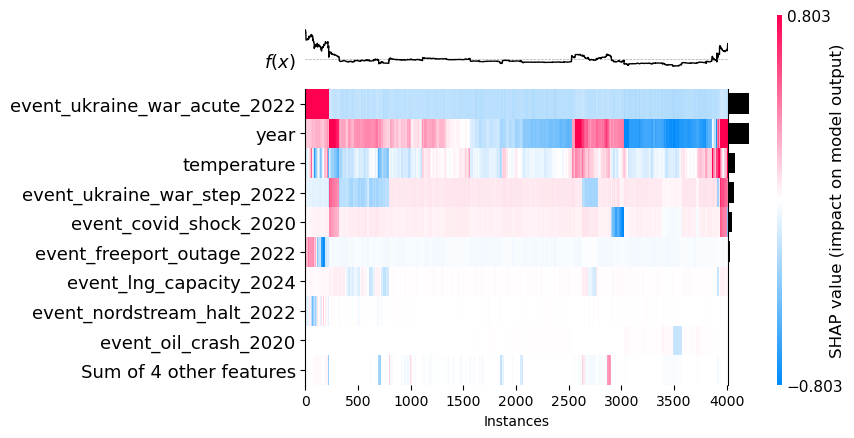

In [ ]:
# Plot SHAP heatmap: the x-axis is not date or integer index of the data!!!
fig, ax = plt.subplots()
shap.plots.heatmap(shap_obj, show=False, ax=ax)
# Set the date for the x-axis, but only show every Nth label to avoid overlap
# N = max(1, len(shap_df['ds']) // 15)  # Show about 15 labels
# xticks = np.arange(0, len(shap_df['ds']), N)
# ax.set_xticks(xticks)
# ax.set_xticklabels(shap_df['ds'].dt.strftime('%Y-%m-%d').iloc[xticks], rotation=45, ha='right')
plt.show()

## Fine tuning with exogenous

In [219]:
# Fine tuning the model with different depths
# Split the validation set based on a specific date
split_date_val = pd.to_datetime("2025-03-31")
validation_exo = test_exo_df[test_exo_df['ds'] < split_date_val]

df_finetune = test_y_exo_df[test_exo_df['ds'] < split_date_val]

# Check the length of validation for each target series
for col in target_cols:
    print(f"{col} validation length: {len(validation_exo[validation_exo['unique_id'] == col])}")

horizon = int(len(validation_exo)/len(target_cols))

depths = [1, 2, 3, 4, 5]
for depth in depths:
    preds_df = nixtla_client.forecast(
        df=train_y_exo_df,
        X_df=validation_exo[['temperature', 'ds', 'unique_id'] + shared_exo_cols],
        # date_features= ['year'], #['dayofweek'], #, 'week', 'month', 'year'],
        h=horizon,
        model='timegpt-1-long-horizon',
        finetune_steps=5,
        finetune_depth=depth,
        feature_contributions=True,
        add_history=True,
    )

    # Merge predictions into df_finetune based on 'ds' and 'unique_id'
    df_finetune = df_finetune.merge(
        preds_df[['ds', 'unique_id', 'TimeGPT']],
        on=['ds', 'unique_id'],
        how='left',
        suffixes=('', f'_depth{depth}')
    )
    # Rename the prediction column to indicate the depth
    df_finetune.rename(columns={'TimeGPT': f'TimeGPT_depth{depth}'}, inplace=True)

INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024']
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...


hh_price validation length: 64
ttf_price validation length: 64
psv_price validation length: 64
jkm_price validation length: 64
pvb_price validation length: 64


INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
INFO:nixtla.nixtla_client:Validating inputs...
INFO:nixtla.nixtla_client:Inferred freq: B
/opt/anaconda3/lib/python3.10/site-packages/nixtla/nixtla_client.py:397: UserWarning:

`df` contains the following exogenous features: ['tFourier', 'tResiduals', 'seasonalAvg', 'seasonalResiduals'], but they were not found in `X_df` nor declared in `hist_exog_list`. They will be ignored.

INFO:nixtla.nixtla_client:Preprocessing dataframes...
INFO:nixtla.nixtla_client:Using future exogenous features: ['temperature', 'event_fukushima_2011', 'event_shale_gas_2012', 'event_covid_shock_2020', 'event_oil_crash_2020', 'event_brexit', 'event_ukraine_war_acute_2022', 'event_ukraine_war_step_2022', 'event_freeport_outage_2022', 'event_nordstream_halt_2022', 'event_eu_price_cap_2022', 'event_lng_capacity_2024']
INFO:nixtla.nixtla_client:Calling Forecast Endpoint...
INFO:nixtla.nixtla_client:Calling Historical Forecast Endpoint...
INFO:nixtla.n

## MAE

In [127]:
df_finetune

,ds,temperature,event_fukushima_2011,event_shale_gas_2012,event_covid_shock_2020,event_oil_crash_2020,event_brexit,event_ukraine_war_acute_2022,event_ukraine_war_step_2022,event_freeport_outage_2022,event_nordstream_halt_2022,event_eu_price_cap_2022,event_lng_capacity_2024,unique_id,TimeGPT_depth1,TimeGPT_depth2,TimeGPT_depth3,TimeGPT_depth4,TimeGPT_depth5
0,2024-12-31,16.119140,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,hh_price,3.123989,2.945631,2.890549,2.891189,2.874698
1,2025-01-01,12.932266,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,hh_price,2.972103,2.772974,2.725298,2.717859,2.710066
2,2025-01-02,9.745392,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,hh_price,3.273173,3.081040,3.027466,3.023256,3.012920
3,2025-01-03,15.032913,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,hh_price,2.958039,2.771125,2.719447,2.724702,2.708133
4,2025-01-06,0.734050,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,hh_price,3.975268,3.787287,3.742645,3.756885,3.744453
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
315,2025-03-24,12.619095,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,pvb_price,41.415130,39.050552,37.837265,37.387894,36.796074
316,2025-03-25,13.741070,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,pvb_price,38.806310,35.589310,34.088800,33.541885,32.974625
317,2025-03-26,14.641190,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,pvb_price,41.296562,38.189934,36.765564,36.185790,35.687500
318,2025-03-27,13.716873,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,pvb_price,38.093163,34.997650,33.531105,32.953580,32.534570


In [220]:
# Evaluate the predictions
metrics = [mae]
evaluation = evaluate(
    df_finetune,
    metrics=metrics,
    models =['TimeGPT_depth1', 'TimeGPT_depth2', 'TimeGPT_depth3', 'TimeGPT_depth4', 'TimeGPT_depth5'],
    time_col="ds",
    target_col="y",
    id_col="unique_id",
    # agg_fn="mean"  # Use mean aggregation for evaluation metrics
)

print(evaluation)

   unique_id metric  TimeGPT_depth1  TimeGPT_depth2  TimeGPT_depth3  \
0   hh_price    mae        0.884064        1.030896        1.050568   
1  jkm_price    mae        0.803581        1.230492        1.413376   
2  psv_price    mae        4.573542        5.413814        5.593427   
3  pvb_price    mae        5.209177        6.082262        6.337813   
4  ttf_price    mae        4.450588        5.118987        5.294250   

   TimeGPT_depth4  TimeGPT_depth5  
0        1.049765        1.033639  
1        1.479101        1.498869  
2        5.563001        5.450538  
3        6.395062        6.330512  
4        5.374742        5.212801  
